In [ ]:
#runthis first
!jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10

In [2]:
#the list of stopwords was taken from kaggle
#jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10
#use this command to increase output amount
from nltk.tokenize import word_tokenize
import nltk
import operator
from sklearn.datasets import fetch_20newsgroups
import numpy as np
from sklearn.model_selection import train_test_split
stopwords =  np.loadtxt('stopwords.txt', dtype = str, delimiter = ' ')

In [3]:
news_groups = fetch_20newsgroups()

#x 
documents = news_groups.data

#y
categories = news_groups.target

list_of_words = [word_tokenize(x) for x in documents]
print(list_of_words)

[['From', ':', 'lerxst', '@', 'wam.umd.edu', '(', 'where', "'s", 'my', 'thing', ')', 'Subject', ':', 'WHAT', 'car', 'is', 'this', '!', '?', 'Nntp-Posting-Host', ':', 'rac3.wam.umd.edu', 'Organization', ':', 'University', 'of', 'Maryland', ',', 'College', 'Park', 'Lines', ':', '15', 'I', 'was', 'wondering', 'if', 'anyone', 'out', 'there', 'could', 'enlighten', 'me', 'on', 'this', 'car', 'I', 'saw', 'the', 'other', 'day', '.', 'It', 'was', 'a', '2-door', 'sports', 'car', ',', 'looked', 'to', 'be', 'from', 'the', 'late', '60s/', 'early', '70s', '.', 'It', 'was', 'called', 'a', 'Bricklin', '.', 'The', 'doors', 'were', 'really', 'small', '.', 'In', 'addition', ',', 'the', 'front', 'bumper', 'was', 'separate', 'from', 'the', 'rest', 'of', 'the', 'body', '.', 'This', 'is', 'all', 'I', 'know', '.', 'If', 'anyone', 'can', 'tellme', 'a', 'model', 'name', ',', 'engine', 'specs', ',', 'years', 'of', 'production', ',', 'where', 'this', 'car', 'is', 'made', ',', 'history', ',', 'or', 'whatever', 'in

In [4]:
x_train, x_test, y_train, y_test = train_test_split(list_of_words, categories, random_state = 1)

In [5]:
words = []
for doc in x_train:
    for word in doc:
        #if length of word is less than 2 then it is stop word (useless)
        #if word is full stop and if the word is 'n't
        #then dont add it to list
        if word.lower() not in stopwords and len(word) != 1 and len(word) != 2 and word != "n't" and word[0] != '.':
            words.append(word)
print(len(words))

1345650


In [6]:
#create a frequency dictionary

def freq_dict(words):
    d = {}
    for i in words:
        if i not in d:
            d[i] = 1
        else:
            d[i] += 1 
    return d
word_freq = freq_dict(words)

In [7]:
sorted_word_freq_rev = dict(sorted(word_freq.items(), key = operator.itemgetter(1), reverse = True))
words = np.array([i for i in sorted_word_freq_rev.keys()])
freq=np.array([i for i in sorted_word_freq_rev.values()])
print(words)
print(freq)

["'AX" 'Subject' 'Lines' ... '8/24GC' 'HARDCOPY' "3.1's"]
[35690  8822  8521 ...     1     1     1]


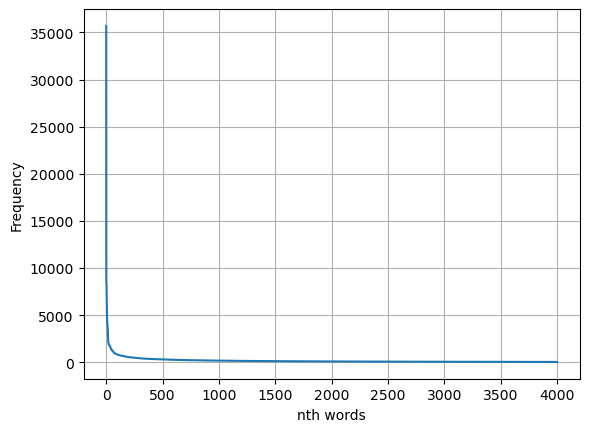

In [8]:
import matplotlib.pyplot as plt
lwrlimit = 0
uprlimit = 4000
dif_btw_xticks = 50
plt.plot(np.arange(len(freq))[lwrlimit:uprlimit], freq[lwrlimit:uprlimit])
plt.xlabel("nth words")
plt.ylabel('Frequency')
plt.grid()
plt.show()

In [30]:
features = words[15:4000]
#using the features with middle number of frequencies

In [31]:
def data_modifier(x_data, features):
    modified_data = np.zeros((len(x_data), len(features)))
    for i in range(len(x_data)):
        curr = x_data[i]
        for word in curr:
            if word in features:
                for j in range(len(features)):
                    if features[j] == word:
                        modified_data[i][j] +=1
    return modified_data

In [32]:
x_train_modified = data_modifier(x_train, features)
x_test_modified = data_modifier(x_test, features)

In [33]:
#inbuilt Multinomimial NB
from sklearn.naive_bayes import MultinomialNB
clf = MultinomialNB()
clf.fit(x_train_modified, y_train)
clf.score(x_test_modified, y_test)

0.8165429480381761

In [34]:
def fit(x_train, y_train):
    count = dict()
    for i in range(20):
        needed_docs = x_train[y_train == i]
        count[i] = dict()
        count[i]['total'] = 0
        for j in range(len(features)):
            count[i][features[j]] = needed_docs[:, j].sum()
            count[i]['total'] += count[i][features[j]]
    return count

In [35]:
#return dict whose keys are different classes need to be classified
# each key has a dict whose keys are features available and value
#each keys is sum of all row of training data of curr_class.
def probability(dictionary, x, curr_class):
    probab_for_each_word = []
    for i in range(len(x)):
        if x[i] != 0:
            numer = dictionary[curr_class][features[i]]
            denom = dictionary[curr_class]['total']
            probab = np.log((numer + 1)/denom + len(x))
            probab_for_each_word.append(probab)
    return sum(probab_for_each_word)

In [36]:
#takes dict given by fit funtion
def predict_single(dic, x):
    classes = dic.keys()
    best_prob = -1000
    best_class = -1
    first_run = True
    for curr_class in classes:
        p_curr_class = probability(dic, x, curr_class)
        if first_run or p_curr_class > best_prob:
            best_prob = p_curr_class
            best_class = curr_class
        first_run = False
    return best_class

In [37]:

def predict(x_test, dic):
    y_pred = []
    for i in x_test:
        y_pred.append(predict_single(dic, i))
    return y_pred

In [38]:
dictionary = fit(x_train_modified, y_train)

In [39]:
y_predicted = predict(x_test_modified, dictionary)

In [40]:
from sklearn.metrics import confusion_matrix
for i in confusion_matrix(y_true = y_test, y_pred = y_predicted):
    for j in i:
        print(j, end = "  ")
    print()

58  1  0  0  0  0  1  3  2  1  0  0  1  1  0  33  0  0  0  13  
0  98  10  17  5  5  9  0  1  4  0  0  0  0  0  1  0  0  0  2  
0  8  105  18  1  2  3  2  0  0  0  0  0  0  0  0  0  0  0  0  
1  8  6  125  3  1  5  1  0  0  0  0  1  0  0  1  0  0  0  0  
0  5  2  33  91  1  4  2  0  0  0  0  0  0  0  0  0  0  0  0  
0  21  9  22  4  86  4  3  2  1  0  0  0  0  0  1  0  0  0  0  
0  2  1  16  2  0  116  5  0  1  0  0  1  0  0  0  0  0  3  0  
1  2  1  5  0  0  13  108  5  2  0  0  0  0  0  0  0  0  0  0  
0  0  1  3  1  0  8  21  91  0  0  0  0  0  0  5  0  0  1  0  
0  0  0  4  0  0  6  0  0  121  1  0  0  0  0  2  0  0  0  1  
0  1  0  0  3  1  4  2  0  28  94  0  0  0  1  1  0  0  0  1  
0  3  0  3  3  3  1  3  3  1  0  118  1  0  0  3  1  0  0  2  
0  15  0  40  10  1  13  17  3  3  0  1  51  0  0  2  0  0  0  1  
4  13  0  7  2  1  6  9  6  9  0  0  1  73  0  10  1  0  3  6  
5  11  2  6  2  0  6  12  4  5  0  0  3  1  84  8  0  0  4  2  
2  2  0  0  0  0  2  1  1  1  0  0  0  0  0

In [41]:
from sklearn.metrics import classification_report
print(classification_report(y_true = y_test, y_pred = y_predicted))

              precision    recall  f1-score   support

           0       0.65      0.51      0.57       114
           1       0.49      0.64      0.56       152
           2       0.77      0.76      0.76       139
           3       0.40      0.82      0.54       152
           4       0.69      0.66      0.68       138
           5       0.85      0.56      0.68       153
           6       0.54      0.79      0.64       147
           7       0.52      0.79      0.63       137
           8       0.71      0.69      0.70       131
           9       0.60      0.90      0.72       135
          10       0.99      0.69      0.81       136
          11       0.97      0.81      0.88       145
          12       0.86      0.32      0.47       157
          13       0.97      0.48      0.65       151
          14       0.99      0.54      0.70       155
          15       0.51      0.92      0.65       159
          16       0.91      0.58      0.71       140
          17       0.98    